# Unsupervised Analysis of Days of Week
Treating crossings each day as features to learn about relationship between various days.

By Jake Vanderplas

In [1]:
## Script created so the local modules created could be found and imported
from pathlib import Path, PureWindowsPath
project_name = 'test-datascience-lab'

sys.path.append(str(Path.cwd().parents[0]).capitalize())

In [2]:
import numpy as np

import pandas as pd
from pandas import Series, DataFrame

import matplotlib.pyplot as plt
from pylab import rcParams

import seaborn as sb
sb.set_style('whitegrid')

from sklearn.decomposition import PCA
from sklearn.mixture import GaussianMixture

%matplotlib inline
rcParams['figure.figsize'] = 15,10

## Get the Fremont Dataset

In [3]:
from src.localingest import get_fremont_dataset

dataset = get_fremont_dataset()

<AxesSubplot:xlabel='time'>

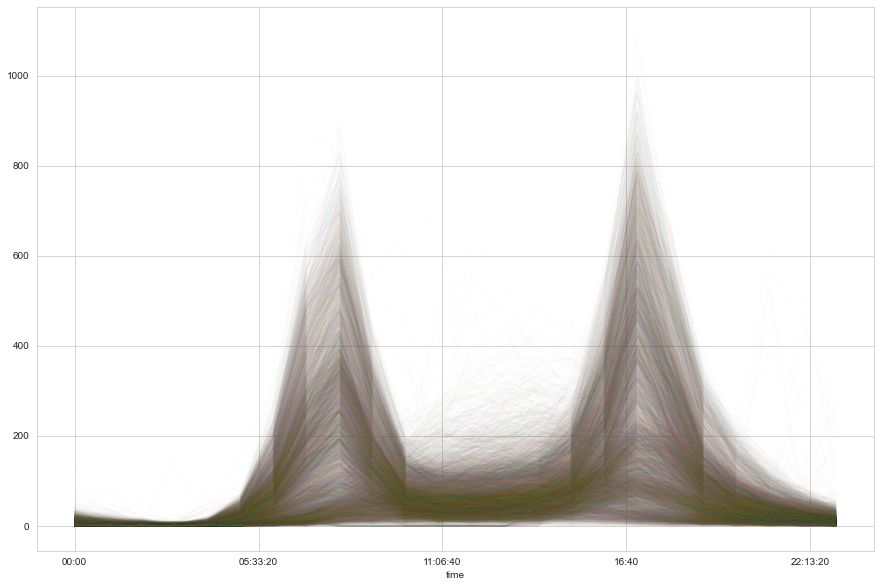

In [4]:
pivoted = pd.pivot_table(dataset, index=dataset.index.time, columns=dataset.index.date)
pivoted.plot(legend=False, alpha=0.01)

## Principal Component Analysis

In [5]:
X1 = pivoted.fillna(0).T.values
X1.shape

(9036, 24)

In [6]:
X2 = PCA(2, svd_solver = 'full').fit_transform(X1)
X2.shape

(9036, 2)

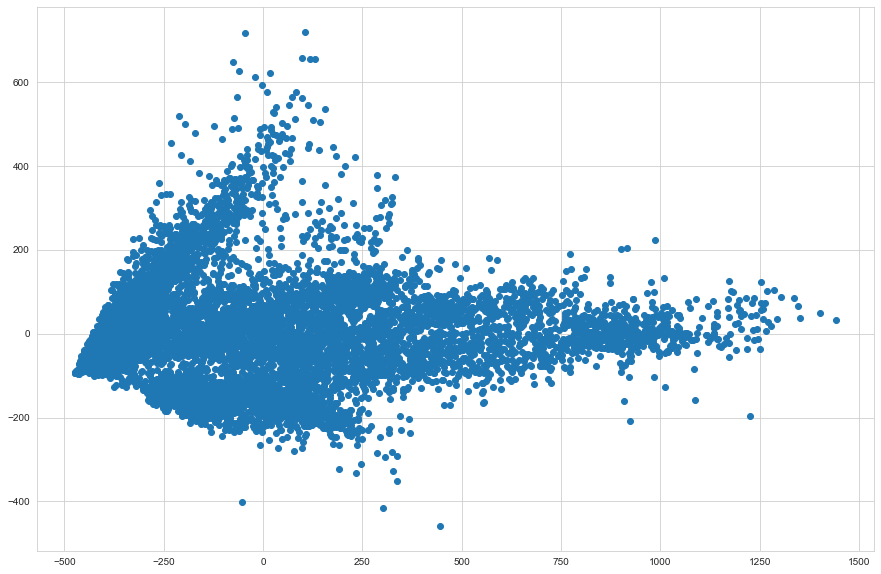

In [7]:
plt.scatter(X2[:,0], X2[:,1])

## Unsupervised Clustering

In [8]:
gmm = GaussianMixture(2).fit(X1)
labels = gmm.predict(X1)

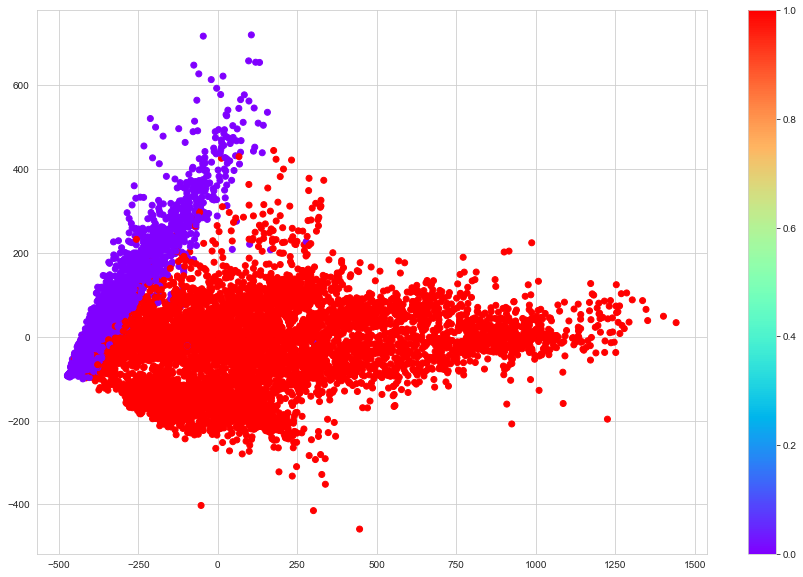

In [9]:
plt.scatter(X2[:,0], X2[:,1], c=labels, cmap='rainbow')
plt.colorbar()

Text(0.5, 1.0, 'Purple Cluster')

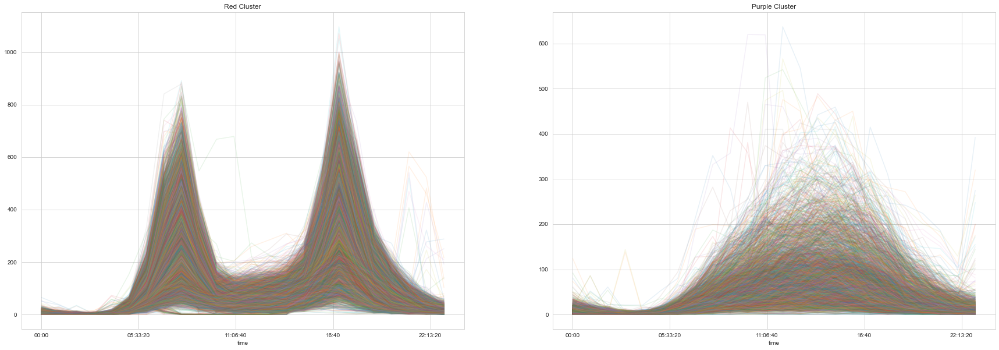

In [10]:
fig, ax = plt.subplots(1,2, figsize=(30,10))

pivoted.T[labels == 1].T.plot(legend=False, alpha=0.1, ax=ax[0])
pivoted.T[labels == 0].T.plot(legend=False, alpha=0.1, ax=ax[1])

ax[0].set_title('Red Cluster')
ax[1].set_title('Purple Cluster')


## Comparing with Day of Week

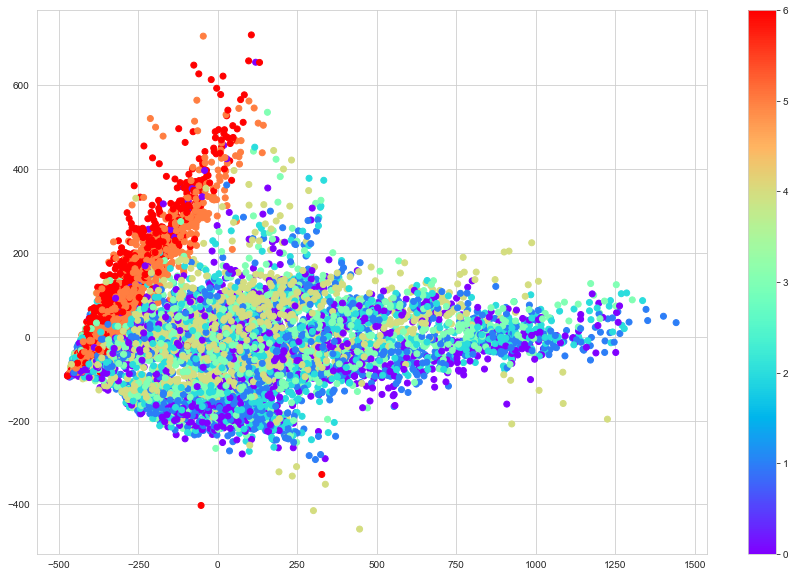

In [11]:
dayofweek = pd.DatetimeIndex(pivoted.columns.get_level_values(1)).dayofweek
plt.scatter(X2[:,0],X2[:,1], c=dayofweek, cmap='rainbow')
plt.colorbar()


## Analyzing Outliers

The following points are weekdays with a holiday-like pattern

In [12]:
dates = pd.DatetimeIndex(pivoted.columns.get_level_values(1))
dates2 = dates[(labels == 0) & (dayofweek < 5)]

dates2[dates2.year==2017]

DatetimeIndex(['2017-01-02', '2017-02-06', '2017-05-29', '2017-09-04',
               '2017-11-23', '2017-11-24', '2017-12-25', '2017-12-26',
               '2017-01-02', '2017-02-06', '2017-05-29', '2017-07-04',
               '2017-09-04', '2017-11-23', '2017-11-24', '2017-12-25',
               '2017-01-02', '2017-02-06', '2017-05-29', '2017-07-04',
               '2017-09-04', '2017-11-23', '2017-11-24', '2017-12-25',
               '2017-12-26', '2017-12-29'],
              dtype='datetime64[ns]', freq=None)

What's up with Feb 6, 2017? [Snow Storm](https://www.seattletimes.com/seattle-news/weather/weather-service-predicts-3-to-6-inches-of-snow-in-seattle-area/)